In [1]:
# Copyright (c) Meta Platforms, Inc. and affiliates.

## Video segmentation and tracking with SAM 3

This notebook demonstrates how to use SAM 3 for interactive video segmentation and dense tracking. It covers the following capabilities:

- **Text prompts**: Using natural language descriptions to segment objects (e.g., "person", "shoe")
- **Point prompts**: Adding positive/negative clicks to segment and refine objects

We use the terms _segment_ or _mask_ to refer to the model prediction for an object on a single frame, and _masklet_ to refer to the spatio-temporal masks across the entire video. 

# <a target="_blank" href="https://colab.research.google.com/github/facebookresearch/sam3/blob/main/notebooks/sam3_video_predictor_example.ipynb">
#   <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
# </a>

In [2]:
using_colab = False

In [3]:
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib scikit-learn
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/sam3.git'

In [4]:
!nvidia-smi

Mon Dec  1 02:57:09 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.95.05              Driver Version: 580.95.05      CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 5090        Off |   00000000:01:00.0  On |                  N/A |
| 30%   45C    P0             85W /  575W |     426MiB /  32607MiB |     13%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

## Set-up

In this example, we allow running inference either on a single GPU or multiple GPUs.

In [5]:
import os
import sam3
import torch

sam3_root = os.path.join(os.path.dirname(sam3.__file__), "..")

# use all available GPUs on the machine
gpus_to_use = range(torch.cuda.device_count())
# # use only a single GPU
# gpus_to_use = [torch.cuda.current_device()]

/home/johnnyas/Coding/cs396_496/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
from sam3.model_builder import build_sam3_video_predictor

predictor = build_sam3_video_predictor(gpus_to_use=gpus_to_use)

INFO 2025-12-01 02:57:10,490 16628 sam3_video_predictor.py: 299: using the following GPU IDs: [0]
INFO 2025-12-01 02:57:10,560 16628 sam3_video_predictor.py: 315: 


	*** START loading model on all ranks ***


INFO 2025-12-01 02:57:10,560 16628 sam3_video_predictor.py: 317: loading model on rank=0 with world_size=1 -- this could take a while ...
INFO 2025-12-01 02:57:13,292 16628 sam3_video_base.py: 124: setting max_num_objects=10000 and num_obj_for_compile=16
INFO 2025-12-01 02:57:14,610 16628 sam3_video_predictor.py: 319: loading model on rank=0 with world_size=1 -- DONE locally
INFO 2025-12-01 02:57:14,611 16628 sam3_video_predictor.py: 330: 


	*** DONE loading model on all ranks ***




#### Inference and visualization utils

In [7]:
import glob
import os

import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from sam3.visualization_utils import (
    load_frame,
    prepare_masks_for_visualization,
    visualize_formatted_frame_output,
)

# font size for axes titles
plt.rcParams["axes.titlesize"] = 12
plt.rcParams["figure.titlesize"] = 12


def propagate_in_video(predictor, session_id):
    # we will just propagate from frame 0 to the end of the video
    outputs_per_frame = {}
    for response in predictor.handle_stream_request(
        request=dict(
            type="propagate_in_video",
            session_id=session_id,
        )
    ):
        outputs_per_frame[response["frame_index"]] = response["outputs"]

    return outputs_per_frame


def abs_to_rel_coords(coords, IMG_WIDTH, IMG_HEIGHT, coord_type="point"):
    """Convert absolute coordinates to relative coordinates (0-1 range)

    Args:
        coords: List of coordinates
        coord_type: 'point' for [x, y] or 'box' for [x, y, w, h]
    """
    if coord_type == "point":
        return [[x / IMG_WIDTH, y / IMG_HEIGHT] for x, y in coords]
    elif coord_type == "box":
        return [
            [x / IMG_WIDTH, y / IMG_HEIGHT, w / IMG_WIDTH, h / IMG_HEIGHT]
            for x, y, w, h in coords
        ]
    else:
        raise ValueError(f"Unknown coord_type: {coord_type}")

### Loading an example video

We assume that the video is stored as either **a list of JPEG frames with filenames like `<frame_index>.jpg`** or **an MP4 video**.

Note that you can extract their JPEG frames using ffmpeg (https://ffmpeg.org/) as follows:
```
ffmpeg -i <your_video>.mp4 -q:v 2 -start_number 0 <output_dir>/'%05d.jpg'
```
where `-q:v` generates high-quality JPEG frames and `-start_number 0` asks ffmpeg to start the JPEG file from `00000.jpg`.

In [8]:
# "video_path" needs to be either a JPEG folder or a MP4 video file
video_path = f"../../dataset/G_smaller.mp4"

In [9]:
# load "video_frames_for_vis" for visualization purposes (they are not used by the model)
if isinstance(video_path, str) and video_path.endswith(".mp4"):
    cap = cv2.VideoCapture(video_path)
    video_frames_for_vis = []
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        video_frames_for_vis.append(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    cap.release()
else:
    video_frames_for_vis = glob.glob(os.path.join(video_path, "*.jpg"))
    try:
        # integer sort instead of string sort (so that e.g. "2.jpg" is before "11.jpg")
        video_frames_for_vis.sort(
            key=lambda p: int(os.path.splitext(os.path.basename(p))[0])
        )
    except ValueError:
        # fallback to lexicographic sort if the format is not "<frame_index>.jpg"
        print(
            f'frame names are not in "<frame_index>.jpg" format: {video_frames_for_vis[:5]=}, '
            f"falling back to lexicographic sort."
        )
        video_frames_for_vis.sort()

### Opening an inference session on this video

SAM 3 requires stateful inference for interactive video segmentation, so we need to initialize an **inference session** on this video.

During initialization, it loads all the video frames and stores their pixels in the session state.

In [10]:
response = predictor.handle_request(
    request=dict(
        type="start_session",
        resource_path=video_path,
    )
)
session_id = response["session_id"]

frame loading (OpenCV) [rank=0]: 100%|██████████| 1327/1327 [00:01<00:00, 700.97it/s]


### Video promptable concept segmentation with text

Using SAM 3 you can describe objects using natural language, and the model will automatically detect and track all instances of that object throughout the video.

In the example below, we add a text prompt on frame 0 and propagation throughout the video. Here we use the text prompt "person" to detect all people in the video. SAM 3 will automatically identify multiple person instances and assign each a unique object ID.

Note that the first call might be slower due to setting up buffers. **You can rerun all the cells below when measuring speed.**

In [11]:
# note: in case you already ran one text prompt and now want to switch to another text prompt
# it's required to reset the session first (otherwise the results would be wrong)
_ = predictor.handle_request(
    request=dict(
        type="reset_session",
        session_id=session_id,
    )
)

propagate_in_video: 100%|██████████| 1327/1327 [01:38<00:00, 13.52it/s]
propagate_in_video: 0it [00:00, ?it/s]
INFO 2025-12-01 02:59:01,295 16628 sam3_video_predictor.py: 250: removed session 83b02a37-81be-4311-a5a2-a3242a80867d; live sessions: [], GPU memory: 5119 MiB used and 24340 MiB reserved (max over time: 23805 MiB used and 24340 MiB reserved)
propagate_in_video: 100%|██████████| 1327/1327 [01:39<00:00, 13.29it/s]
propagate_in_video: 0it [00:00, ?it/s]
INFO 2025-12-01 03:00:45,146 16628 sam3_video_predictor.py: 250: removed session e8b961b2-3a1f-4148-9d9b-94b69fd0e0d1; live sessions: [], GPU memory: 5119 MiB used and 24356 MiB reserved (max over time: 23820 MiB used and 24356 MiB reserved)


Objects found in frame 0: [0, 1000]


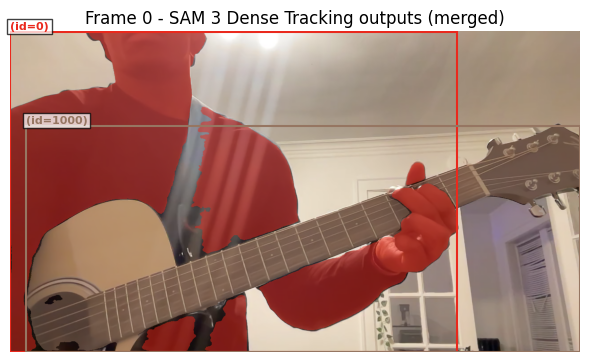

In [12]:
frame_idx = 0
session_id_1 = response["session_id"]

predictor.handle_request(
    request=dict(
        type="add_prompt", session_id=session_id_1,
        frame_index=frame_idx, text="person"
    )
)
outputs_1 = propagate_in_video(predictor, session_id_1)
outputs_1 = prepare_masks_for_visualization(outputs_1)

predictor.handle_request(request=dict(type="close_session", session_id=session_id_1))

# === Session 2: Second concept ===
response = predictor.handle_request(
    request=dict(type="start_session", resource_path=video_path)
)
session_id_2 = response["session_id"]

predictor.handle_request(
    request=dict(
        type="add_prompt", session_id=session_id_2,
        frame_index=frame_idx, text="guitar"
    )
)
outputs_2 = propagate_in_video(predictor, session_id_2)
outputs_2 = prepare_masks_for_visualization(outputs_2)

predictor.handle_request(request=dict(type="close_session", session_id=session_id_2))

# === Merge results ===
def merge_outputs(outputs_1, outputs_2, id_offset=1000):
    """Merge two output dictionaries (already prepared by prepare_masks_for_visualization),
    offsetting IDs in the second to avoid collisions.
    """
    merged = {}
    # iterate over all frames present in either dict
    all_frames = sorted(set(list(outputs_1.keys()) + list(outputs_2.keys())))
    for fidx in all_frames:
        merged[fidx] = {}
        if fidx in outputs_1:
            merged[fidx].update(outputs_1[fidx])
        if fidx in outputs_2:
            # offset IDs from the second set
            for obj_id, mask in outputs_2[fidx].items():
                merged[fidx][obj_id + id_offset] = mask
    return merged

# Merge the prepared outputs
merged_outputs = merge_outputs(outputs_1, outputs_2)

# For compatibility with existing code that expects variable "out"
out = merged_outputs

# Debug: list object ids found on the selected frame
if frame_idx in out:
    print(f"Objects found in frame {frame_idx}: {list(out[frame_idx].keys())}")
else:
    print(f"No outputs for frame {frame_idx}")

# Visualize the merged outputs (they are already prepared with prepare_masks_for_visualization)
plt.close("all")
visualize_formatted_frame_output(
    frame_idx,
    video_frames_for_vis,
    outputs_list=[out],
    titles=["SAM 3 Dense Tracking outputs (merged)"],
    figsize=(6, 4),
)

In [ ]:
# # now we propagate the outputs from frame 0 to the end of the video and collect all outputs
# outputs_per_frame = merged_outputs

# # finally, we reformat the outputs for visualization and plot the outputs every 60 frames
# outputs_per_frame = prepare_masks_for_visualization(outputs_per_frame)

# vis_frame_stride = 60
# plt.close("all")
# for frame_idx in range(0, len(outputs_per_frame), vis_frame_stride):
#     visualize_formatted_frame_output(
#         frame_idx,
#         video_frames_for_vis,
#         outputs_list=[outputs_per_frame],
#         titles=["SAM 3 Dense Tracking outputs"],
#         figsize=(6, 4),
#     )

KeyError: 'out_obj_ids'

###  Removing objects

We can remove individual objects using their id.

As an example, let's remove object 2 (which is the dancer in the front).

In [ ]:
# # we pick id 2, which is the dancer in the front
# obj_id = 0
# response = predictor.handle_request(
#     request=dict(
#         type="remove_object",
#         session_id=session_id,
#         obj_id=obj_id,
#     )
# )

In [ ]:
# # now we propagate the outputs from frame 0 to the end of the video and collect all outputs
# outputs_per_frame = propagate_in_video(predictor, session_id)

# # finally, we reformat the outputs for visualization and plot the outputs every 60 frames
# outputs_per_frame = prepare_masks_for_visualization(outputs_per_frame)

# vis_frame_stride = 60
# plt.close("all")
# for frame_idx in range(0, len(outputs_per_frame), vis_frame_stride):
#     visualize_formatted_frame_output(
#         frame_idx,
#         video_frames_for_vis,
#         outputs_list=[outputs_per_frame],
#         titles=["SAM 3 Dense Tracking outputs"],
#         figsize=(6, 4),
#     )

### Adding new objects with point prompts

We can add new objects through point prompts.

Assuming that we've changed our mind, and now that we want to add back the dancer in the front (whom we just removed in the step above). We can use interactive clicks to add her back.

In [ ]:
sample_img = Image.fromarray(load_frame(video_frames_for_vis[0]))

IMG_WIDTH, IMG_HEIGHT = sample_img.size

In [ ]:
# let's add back the dancer via point prompts.
# we will use a single positive click to add the dancer back.

frame_idx = 0
obj_id = 1
points_abs = np.array(
    [
        [100, 500],  # positive click
    ]
)
# positive clicks have label 1, while negative clicks have label 0
labels = np.array([1])

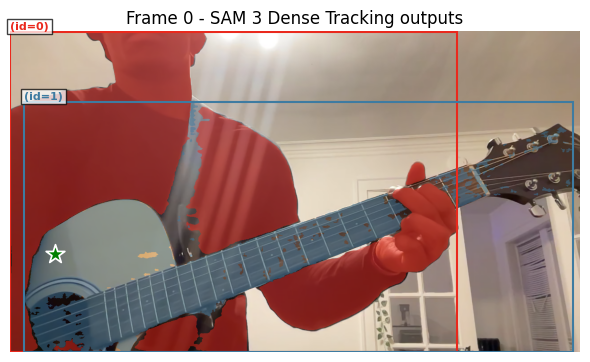

In [ ]:
# convert points and labels to tensors; also convert to relative coordinates
points_tensor = torch.tensor(
    abs_to_rel_coords(points_abs, IMG_WIDTH, IMG_HEIGHT, coord_type="point"),
    dtype=torch.float32,
)
points_labels_tensor = torch.tensor(labels, dtype=torch.int32)

response = predictor.handle_request(
    request=dict(
        type="add_prompt",
        session_id=session_id,
        frame_index=frame_idx,
        points=points_tensor,
        point_labels=points_labels_tensor,

        obj_id=obj_id,
    )
)
out = response["outputs"]

plt.close("all")
visualize_formatted_frame_output(
    frame_idx,
    video_frames_for_vis,
    outputs_list=[prepare_masks_for_visualization({frame_idx: out})],
    titles=["SAM 3 Dense Tracking outputs"],
    figsize=(6, 4),
    points_list=[points_abs],
    points_labels_list=[labels],
)

In [ ]:
# now we propagate the outputs from frame 0 to the end of the video and collect all outputs
outputs_per_frame = propagate_in_video(predictor, session_id)

# finally, we reformat the outputs for visualization and plot the outputs every 60 frames
outputs_per_frame = prepare_masks_for_visualization(outputs_per_frame)

vis_frame_stride = 60
plt.close("all")
for frame_idx in range(0, len(outputs_per_frame), vis_frame_stride):
    visualize_formatted_frame_output(
        frame_idx,
        video_frames_for_vis,
        outputs_list=[outputs_per_frame],
        titles=["SAM 3 Dense Tracking outputs"],
        figsize=(6, 4),
    )

 56%|█████▋    | 748/1327 [00:53<00:41, 14.07it/s]


KeyboardInterrupt: 

### Refining an existing object with point prompts

We can also refine the segmentation mask of an existing object through point prompts.

Assuming that we've changed our mind (again) -- for Object ID 2 (the dancer in the front whom we just added back in the step above), now we only want to segment her T-shirt instead of her whole body. We can adjust the segmentation mask with a few more positive and negative clicks.

In [ ]:
# # For the dancer in the front, suppose now we only want to segment her T-shirt instead of her whole body
# # we will use 2 positive clicks and 2 negative clicks to select her shirt.

# frame_idx = 0
# obj_id = 2
# points_abs = np.array(
#     [
#         [740, 450],  # positive click
#         [760, 630],  # negative click
#         [840, 640],  # negative click
#         [760, 550],  # positive click
#     ]
# )
# # positive clicks have label 1, while negative clicks have label 0
# labels = np.array([1, 0, 0, 1])

In [ ]:
# # convert points and labels to tensors; also convert to relative coordinates
# points_tensor = torch.tensor(
#     abs_to_rel_coords(points_abs, IMG_WIDTH, IMG_HEIGHT, coord_type="point"),
#     dtype=torch.float32,
# )
# points_labels_tensor = torch.tensor(labels, dtype=torch.int32)

# response = predictor.handle_request(
#     request=dict(
#         type="add_prompt",
#         session_id=session_id,
#         frame_index=frame_idx,
#         points=points_tensor,
#         point_labels=points_labels_tensor,
#         obj_id=obj_id,
#     )
# )
# out = response["outputs"]

# plt.close("all")
# visualize_formatted_frame_output(
#     frame_idx,
#     video_frames_for_vis,
#     outputs_list=[prepare_masks_for_visualization({frame_idx: out})],
#     titles=["SAM 3 Dense Tracking outputs"],
#     figsize=(6, 4),
#     points_list=[points_abs],
#     points_labels_list=[labels],
# )

In [ ]:
# # now we propagate the outputs from frame 0 to the end of the video and collect all outputs
# outputs_per_frame = propagate_in_video(predictor, session_id)

# # finally, we reformat the outputs for visualization and plot the outputs every 60 frames
# outputs_per_frame = prepare_masks_for_visualization(outputs_per_frame)

# vis_frame_stride = 60
# plt.close("all")
# for frame_idx in range(0, len(outputs_per_frame), vis_frame_stride):
#     visualize_formatted_frame_output(
#         frame_idx,
#         video_frames_for_vis,
#         outputs_list=[outputs_per_frame],
#         titles=["SAM 3 Dense Tracking outputs"],
#         figsize=(6, 4),
#     )

Object IDs in mask: [0, 1000]
Integer mask unique values: [   0    1 1001]


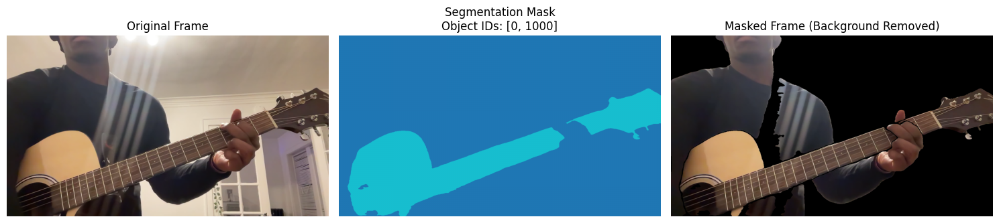

Object 0: 268624 pixels
Object 1000: 179373 pixels


In [17]:


def create_masked_frame(frame, mask_dict, keep_ids=None):
    """
    Black out everything except the segmented objects.
    
    Args:
        frame: RGB image (H, W, 3)
        mask_dict: Dictionary {obj_id: boolean_mask} from prepare_masks_for_visualization
        keep_ids: List of object IDs to keep. If None, keep all IDs.
    
    Returns:
        Masked frame with background blacked out
    """
    masked_frame = np.zeros_like(frame)
    
    # Handle the dict format from prepare_masks_for_visualization
    if isinstance(mask_dict, dict):
        for obj_id, bool_mask in mask_dict.items():
            if keep_ids is None or obj_id in keep_ids:
                masked_frame[bool_mask] = frame[bool_mask]
    else:
        # Fallback: assume it's already an integer mask
        if keep_ids is None:
            obj_mask = mask_dict > 0
        else:
            obj_mask = np.isin(mask_dict, keep_ids)
        masked_frame[obj_mask] = frame[obj_mask]
    
    return masked_frame


def mask_dict_to_int_mask(mask_dict):
    """Convert dict of boolean masks to single integer mask for visualization."""
    if not mask_dict:
        return None
    
    # Get shape from first mask
    first_mask = next(iter(mask_dict.values()))
    int_mask = np.zeros(first_mask.shape, dtype=np.int32)
    
    for obj_id, bool_mask in mask_dict.items():
        int_mask[bool_mask] = obj_id + 1  # +1 so background stays 0
    
    return int_mask


# Visualize a single frame with background removed
frame_idx = 0
frame = video_frames_for_vis[frame_idx]
mask_dict = outputs_per_frame[frame_idx]

# Convert to integer mask for visualization
int_mask = mask_dict_to_int_mask(mask_dict)

# Debug
print(f"Object IDs in mask: {list(mask_dict.keys())}")
print(f"Integer mask unique values: {np.unique(int_mask)}")

# Create masked frame
masked_frame = create_masked_frame(frame, mask_dict)

# Display side by side
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].imshow(frame)
axes[0].set_title("Original Frame")
axes[0].axis('off')

axes[1].imshow(int_mask, cmap='tab10')
axes[1].set_title(f"Segmentation Mask\nObject IDs: {list(mask_dict.keys())}")
axes[1].axis('off')

axes[2].imshow(masked_frame)
axes[2].set_title("Masked Frame (Background Removed)")
axes[2].axis('off')

plt.tight_layout()
plt.show()

# Debug info
for obj_id, bool_mask in mask_dict.items():
    print(f"Object {obj_id}: {np.sum(bool_mask)} pixels")

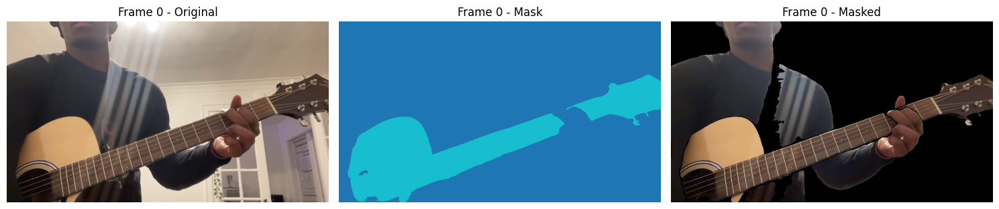

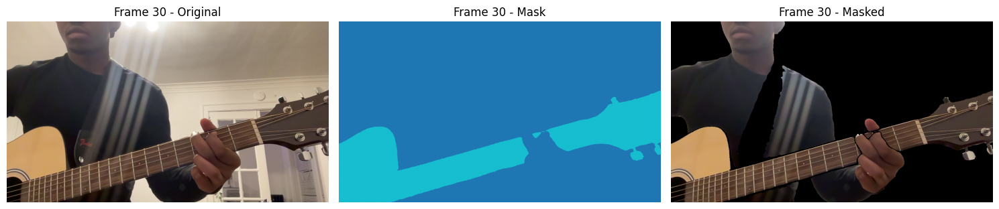

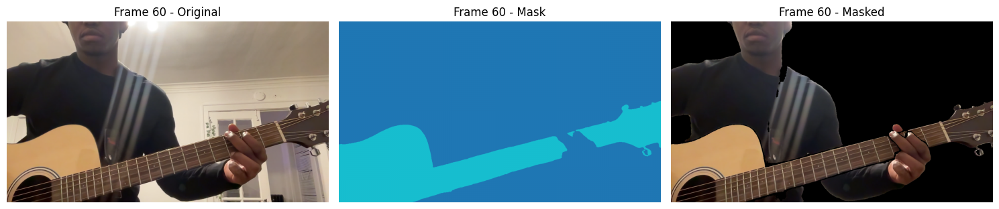

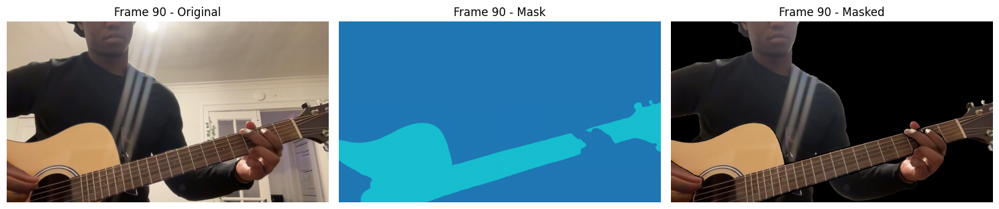

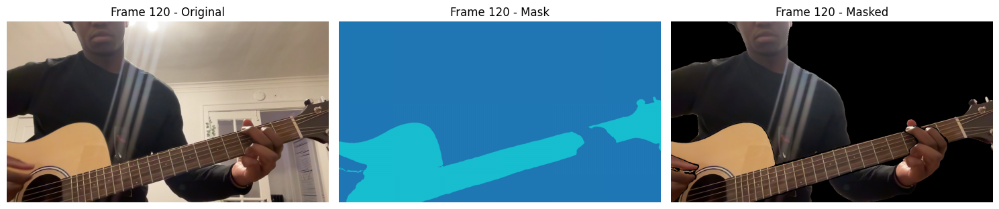

...

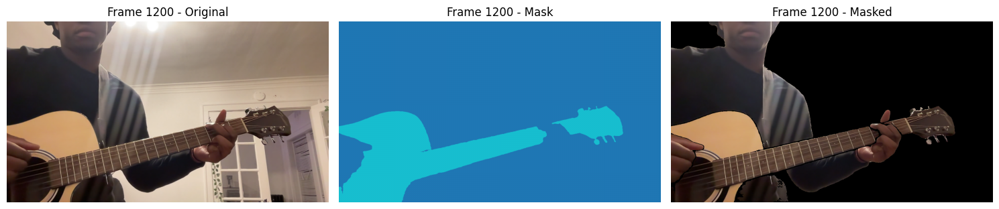

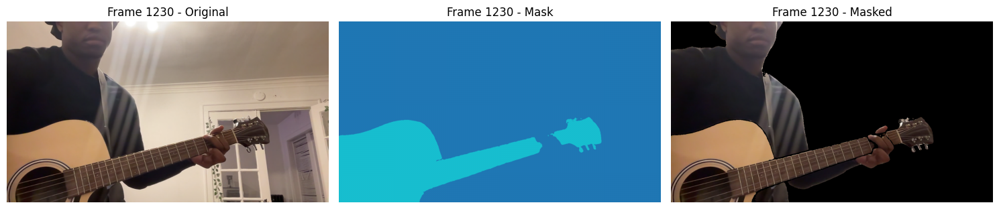

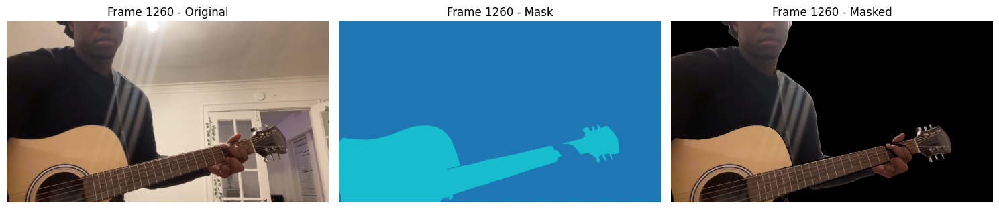

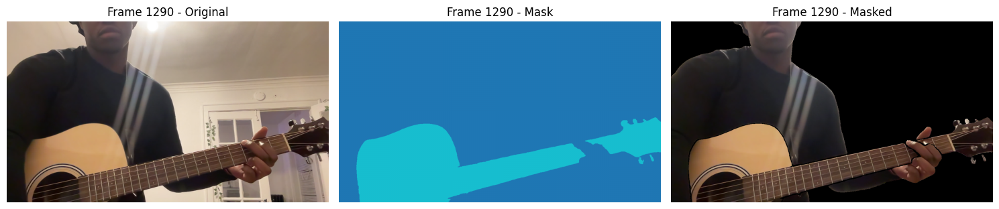

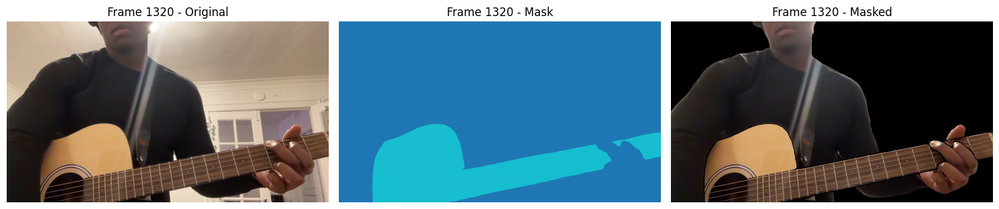

In [18]:
# Visualize masked frames at regular intervals

vis_frame_stride = 30  # Show every 30 frames (adjust as needed)

plt.close("all")
for frame_idx in range(0, len(outputs_per_frame), vis_frame_stride):
    frame = video_frames_for_vis[frame_idx]
    mask_dict = outputs_per_frame[frame_idx]
    
    # Create masked frame
    masked_frame = create_masked_frame(frame, mask_dict)
    
    # Convert to int mask for visualization
    int_mask = mask_dict_to_int_mask(mask_dict)
    
    # Display
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    axes[0].imshow(frame)
    axes[0].set_title(f"Frame {frame_idx} - Original")
    axes[0].axis('off')
    
    axes[1].imshow(int_mask, cmap='tab10')
    axes[1].set_title(f"Frame {frame_idx} - Mask")
    axes[1].axis('off')
    
    axes[2].imshow(masked_frame)
    axes[2].set_title(f"Frame {frame_idx} - Masked")
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

In [19]:
# Save masked frames as video

output_path = "masked_output.mp4"
fps = 30  # Adjust to match your source video

# Get frame dimensions
h, w = video_frames_for_vis[0].shape[:2]

# Create video writer
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out_video = cv2.VideoWriter(output_path, fourcc, fps, (w, h))

for frame_idx in range(len(outputs_per_frame)):
    frame = video_frames_for_vis[frame_idx]
    mask_dict = outputs_per_frame[frame_idx]
    
    # Create masked frame
    masked_frame = create_masked_frame(frame, mask_dict)
    
    # Convert RGB to BGR for OpenCV
    out_video.write(cv2.cvtColor(masked_frame, cv2.COLOR_RGB2BGR))

out_video.release()
print(f"Saved masked video to {output_path}")

Saved masked video to masked_output.mp4


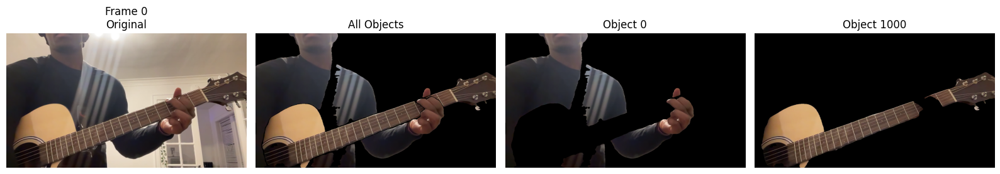

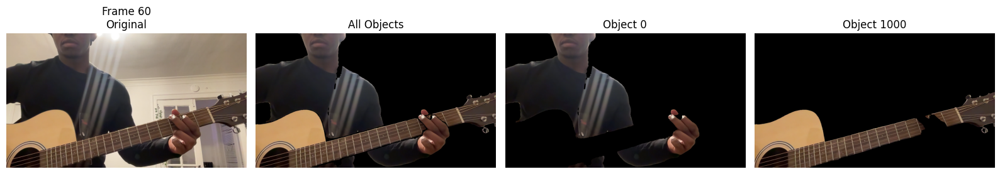

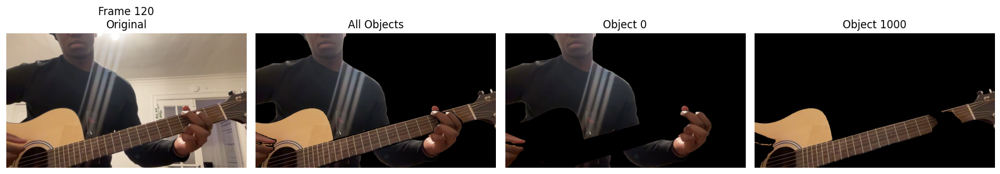

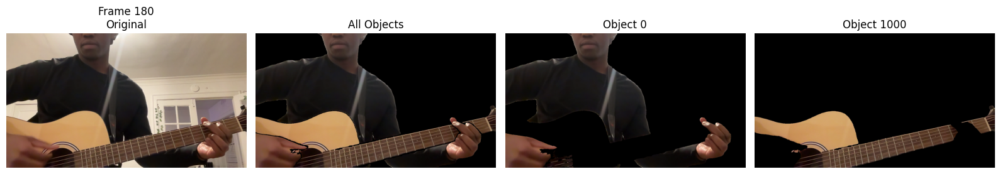

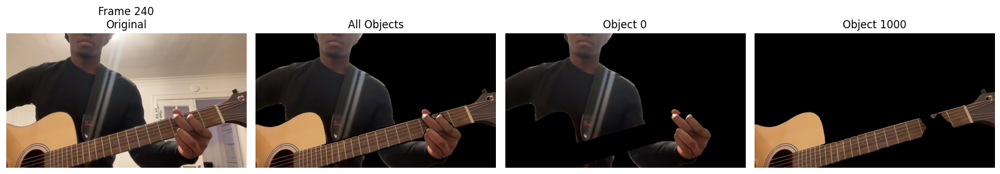

...

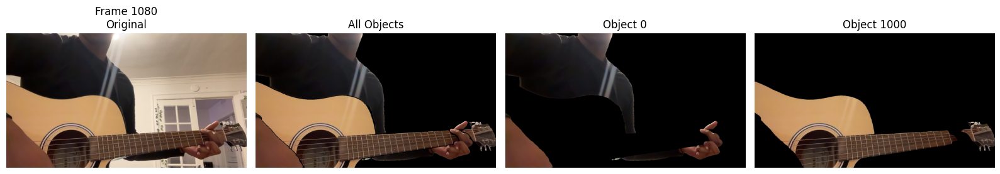

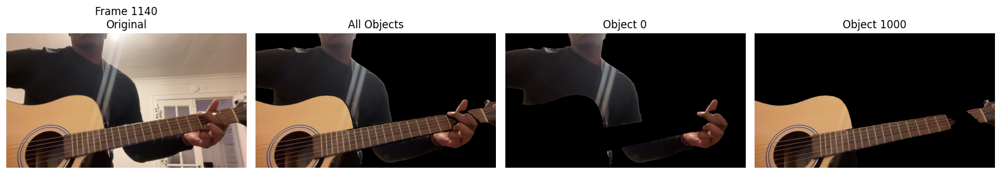

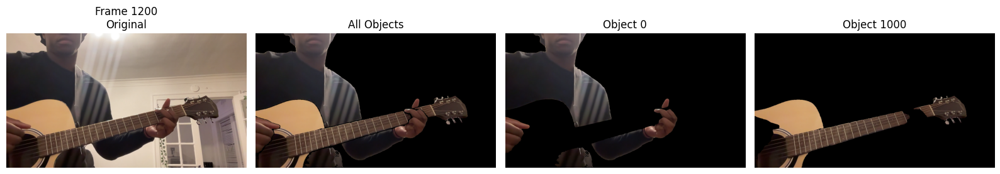

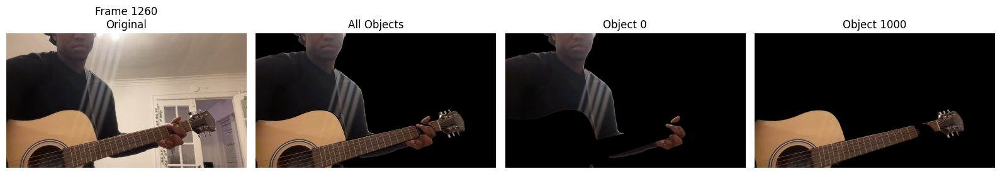

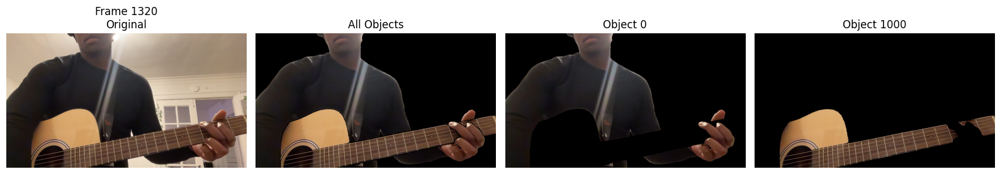

In [20]:
# Show each object separately at selected frames

vis_frame_stride = 60

for frame_idx in range(0, len(outputs_per_frame), vis_frame_stride):
    frame = video_frames_for_vis[frame_idx]
    mask_dict = outputs_per_frame[frame_idx]
    
    num_objects = len(mask_dict)
    fig, axes = plt.subplots(1, num_objects + 2, figsize=(4 * (num_objects + 2), 4))
    
    # Original
    axes[0].imshow(frame)
    axes[0].set_title(f"Frame {frame_idx}\nOriginal")
    axes[0].axis('off')
    
    # All objects combined
    masked_all = create_masked_frame(frame, mask_dict)
    axes[1].imshow(masked_all)
    axes[1].set_title("All Objects")
    axes[1].axis('off')
    
    # Each object separately
    for i, (obj_id, bool_mask) in enumerate(mask_dict.items()):
        single_obj = np.zeros_like(frame)
        single_obj[bool_mask] = frame[bool_mask]
        axes[i + 2].imshow(single_obj)
        axes[i + 2].set_title(f"Object {obj_id}")
        axes[i + 2].axis('off')
    
    plt.tight_layout()
    plt.show()

In [22]:
def get_cropped_region(frame, mask_dict, pad=20):
    """
    Extract tight crop around all segmented objects.
    Crop adjusts dynamically based on where the mask is each frame.
    """
    # Combine all object masks into one
    combined_mask = np.zeros(frame.shape[:2], dtype=bool)
    for bool_mask in mask_dict.values():
        combined_mask |= bool_mask
    
    if not combined_mask.any():
        return frame, (0, frame.shape[0], 0, frame.shape[1])  # Fallback
    
    # Find bounding box of the mask (THIS CHANGES EACH FRAME)
    rows = np.any(combined_mask, axis=1)
    cols = np.any(combined_mask, axis=0)
    rmin, rmax = np.where(rows)[0][[0, -1]]
    cmin, cmax = np.where(cols)[0][[0, -1]]
    
    # Add padding
    h, w = frame.shape[:2]
    rmin = max(0, rmin - pad)
    rmax = min(h - 1, rmax + pad)
    cmin = max(0, cmin - pad)
    cmax = min(w - 1, cmax + pad)
    
    # Crop the frame
    crop = frame[rmin:rmax+1, cmin:cmax+1].copy()
    
    # Optionally black out background within crop
    crop_mask = combined_mask[rmin:rmax+1, cmin:cmax+1]
    crop[~crop_mask] = 0
    
    return crop, (rmin, rmax, cmin, cmax)

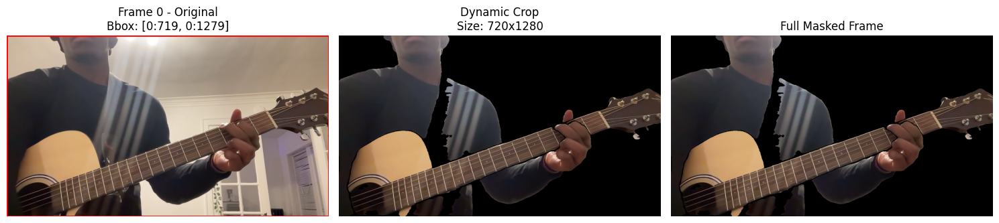

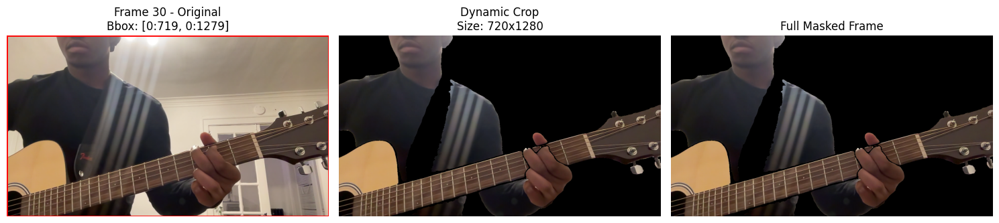

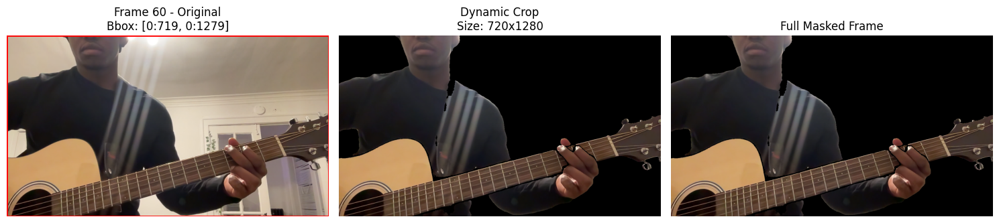

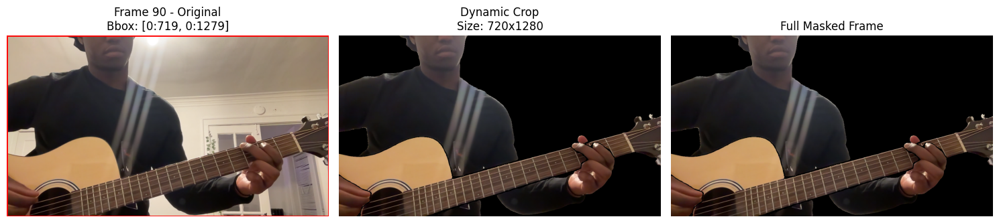

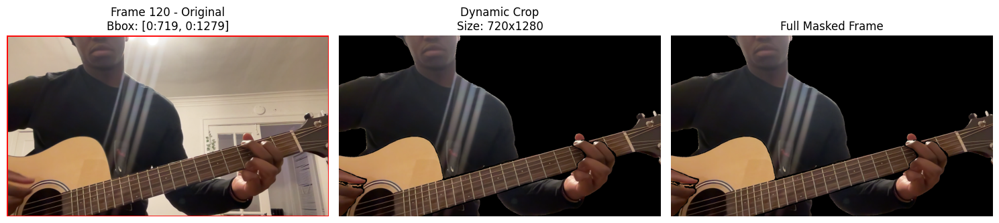

...

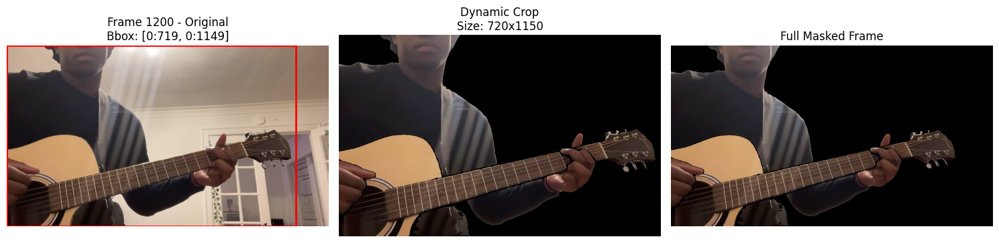

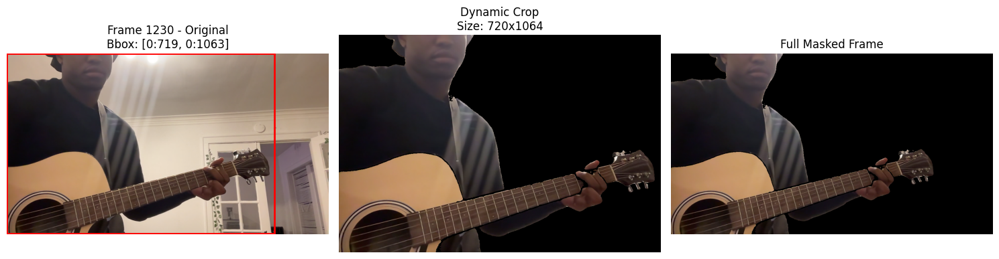

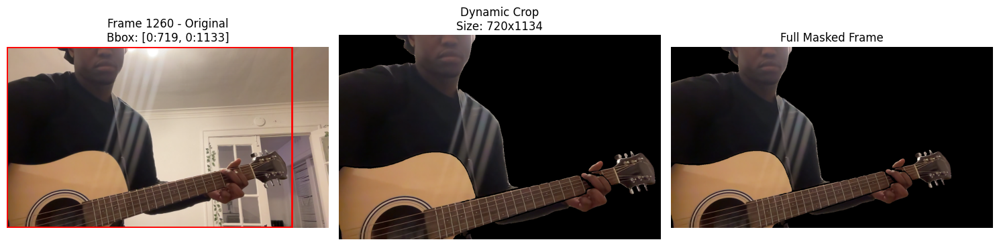

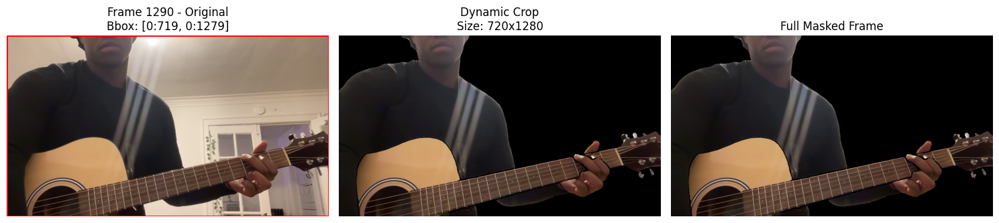

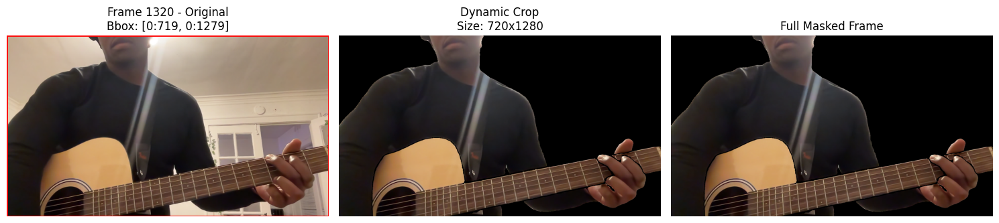

In [23]:
# Visualize dynamic cropping across frames

vis_frame_stride = 30

plt.close("all")
for frame_idx in range(0, len(outputs_per_frame), vis_frame_stride):
    frame = video_frames_for_vis[frame_idx]
    mask_dict = outputs_per_frame[frame_idx]
    
    # Get dynamic crop
    crop, (rmin, rmax, cmin, cmax) = get_cropped_region(frame, mask_dict, pad=20)
    
    # Display
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    # Original with bounding box drawn
    axes[0].imshow(frame)
    rect = plt.Rectangle((cmin, rmin), cmax-cmin, rmax-rmin, 
                          fill=False, edgecolor='red', linewidth=2)
    axes[0].add_patch(rect)
    axes[0].set_title(f"Frame {frame_idx} - Original\nBbox: [{rmin}:{rmax}, {cmin}:{cmax}]")
    axes[0].axis('off')
    
    # Cropped region (dynamic size)
    axes[1].imshow(crop)
    axes[1].set_title(f"Dynamic Crop\nSize: {crop.shape[0]}x{crop.shape[1]}")
    axes[1].axis('off')
    
    # Full masked frame for comparison
    masked_full = create_masked_frame(frame, mask_dict)
    axes[2].imshow(masked_full)
    axes[2].set_title("Full Masked Frame")
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

### Close session

Each session is tied to a single video. We can close the session after inference to free up its resources.

(Then, you may start a new session on another video.)

In [ ]:
# finally, close the inference session to free its GPU resources
# (you may start a new session on another video)
_ = predictor.handle_request(
    request=dict(
        type="close_session",
        session_id=session_id,
    )
)

INFO 2025-12-01 02:39:16,468 6177 sam3_video_predictor.py: 250: removed session 793d7121-5ad8-4bb5-8c3c-a87d61adf3e2; live sessions: [], GPU memory: 5119 MiB used and 27246 MiB reserved (max over time: 26376 MiB used and 27246 MiB reserved)


### Clean-up

After all inference is done, we can shutdown the predictor to free up the multi-GPU process group.

In [ ]:
# after all inference is done, we can shutdown the predictor
# to free up the multi-GPU process group
predictor.shutdown()